# Fenotipos computacionales de morbilidad materna

En este notebook se presentará el análisis de tres fenotipos computacionales de morbilidad materna con el uso de la base de datos sintética desarrollada. La cual se puede encontrar en el siguiente enlace: [Maternal Health in Colombia: Synthetic Data
](https://www.kaggle.com/datasets/evertorres/maternal-health-in-colombia-synthetic-data).

In [169]:
# Carga de librerias: 
import pandas as pd

from sklearn.impute import SimpleImputer
import numpy as np

from sklearn.preprocessing import LabelEncoder

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier 
from scipy.stats import uniform, randint

import joblib

La matriz de características se construyó con base en el código desarrollado por [Jonathan Badger](https://github.com/jbadger3/ml_4_pheno_ooe) como material suplementario del articulo: 

Badger, J., LaRose, E., Mayer, J., Bashiri, F., Page, D., & Peissig, P. (2019). Machine learning for phenotyping opioid overdose events. <em>Journal of biomedical informatics</em>, 94, 103185.

In [170]:
# Cargamos las características contínuas
features_cont = pd.read_csv('OMOP_featur    es/omop_features_cont.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'OMOP_featur    es/omop_features_cont.csv'

In [171]:
#Evaluamos el conjunto de datos. 
#Contar NaN por columnas. 
nan_percentage = features_cont.isna().sum() / len(features_cont)
nan_percentage

age_at_pregnancy              0.000000
min-meas_CONCEPT_3000876      0.990457
max-meas_CONCEPT_3000876      0.990457
mean-meas_CONCEPT_3000876     0.990457
min-meas_CONCEPT_3001247      0.990457
                                ...   
max-meas_CONCEPT_3046581      0.999876
mean-meas_CONCEPT_3046581     0.999876
min-meas_CONCEPT_36203175     0.999876
max-meas_CONCEPT_36203175     0.999876
mean-meas_CONCEPT_36203175    0.999876
Length: 358, dtype: float64

In [172]:
#Eliminar columnas con mayoría de NaN
threshold = 0.6
features_cont_cleaned = features_cont.loc[:, features_cont.isna().mean() < threshold]
print(f"Columnas con mas de {threshold*100}% de datos NaN", len(features_cont_cleaned.columns))

Columnas con mas de 60.0% de datos NaN 25


In [173]:
nan_percentage_cleaned = features_cont_cleaned.isna().sum() / len(features_cont)
nan_percentage_cleaned

age_at_pregnancy              0.000000
min-meas_CONCEPT_3004249      0.574173
max-meas_CONCEPT_3004249      0.574173
mean-meas_CONCEPT_3004249     0.574173
min-meas_CONCEPT_3012888      0.574173
max-meas_CONCEPT_3012888      0.574173
mean-meas_CONCEPT_3012888     0.574173
min-meas_CONCEPT_3024171      0.576899
max-meas_CONCEPT_3024171      0.576899
mean-meas_CONCEPT_3024171     0.576899
min-meas_CONCEPT_3025315      0.584459
max-meas_CONCEPT_3025315      0.584459
mean-meas_CONCEPT_3025315     0.584459
min-meas_CONCEPT_3027018      0.576899
max-meas_CONCEPT_3027018      0.576899
mean-meas_CONCEPT_3027018     0.576899
min-meas_CONCEPT_3036277      0.585822
max-meas_CONCEPT_3036277      0.585822
mean-meas_CONCEPT_3036277     0.585822
min-meas_CONCEPT_3038553      0.585822
max-meas_CONCEPT_3038553      0.585822
mean-meas_CONCEPT_3038553     0.585822
min-meas_CONCEPT_43055141     0.549139
max-meas_CONCEPT_43055141     0.549139
mean-meas_CONCEPT_43055141    0.549139
dtype: float64

In [174]:
# Inputamos los valores NaN
imputer_cont = SimpleImputer(strategy="mean")
features_cont_cleaned_imputed = imputer_cont.fit_transform(features_cont_cleaned)
features_cont_cleaned_imputed = pd.DataFrame(features_cont_cleaned_imputed, columns=features_cont_cleaned.columns)
features_cont_cleaned_imputed.head()

,age_at_pregnancy,min-meas_CONCEPT_3004249,max-meas_CONCEPT_3004249,mean-meas_CONCEPT_3004249,min-meas_CONCEPT_3012888,max-meas_CONCEPT_3012888,mean-meas_CONCEPT_3012888,min-meas_CONCEPT_3024171,max-meas_CONCEPT_3024171,mean-meas_CONCEPT_3024171,...,mean-meas_CONCEPT_3027018,min-meas_CONCEPT_3036277,max-meas_CONCEPT_3036277,mean-meas_CONCEPT_3036277,min-meas_CONCEPT_3038553,max-meas_CONCEPT_3038553,mean-meas_CONCEPT_3038553,min-meas_CONCEPT_43055141,max-meas_CONCEPT_43055141,mean-meas_CONCEPT_43055141
0,22.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,80.054525,163.01906,163.021275,163.020202,24.016038,24.030132,24.023009,2.197911,2.671798,2.446709
1,16.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,80.054525,163.01906,163.021275,163.020202,24.016038,24.030132,24.023009,2.197911,2.671798,2.446709
2,16.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,80.054525,163.01906,163.021275,163.020202,24.016038,24.030132,24.023009,2.197911,2.671798,2.446709
3,17.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,80.054525,163.01906,163.021275,163.020202,24.016038,24.030132,24.023009,2.197911,2.671798,2.446709
4,19.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,80.054525,163.01906,163.021275,163.020202,24.016038,24.030132,24.023009,2.197911,2.671798,2.446709


In [175]:
#Cargamos las características discretas
features_disc = pd.read_csv('OMOP_features/omop_features_disc.csv')

In [176]:
#Evaluamos el conjunto de datos. 
#Contar NaN por columnas. 
nan_percentage_disc = features_disc.isna().sum() / len(features_cont)
nan_percentage_disc

lt15_person_age            0.000000
gt45_person_age            0.000000
cnt-pro_CONCEPT_4075363    0.211550
cnt-pro_CONCEPT_4168236    0.246871
cnt-pro_CONCEPT_4082534    0.354071
                             ...   
cnt-cond_CONCEPT_440448    0.999752
cnt-pro_CONCEPT_4198190    0.999752
cnt-obs_CONCEPT_4224654    0.999876
cnt-obs_CONCEPT_4122068    0.999876
cnt-pro_CONCEPT_4040791    0.999876
Length: 315, dtype: float64

In [177]:
#Eliminar columnas con mayoría de NaN
threshold = 0.6
features_disc_cleaned = features_disc.loc[:, features_disc.isna().mean() < threshold]
print(f"Columnas con mas de {threshold*100}% de datos NaN", len(features_disc_cleaned.columns))

Columnas con mas de 60.0% de datos NaN 10


In [178]:
nan_percentage_disc_cleaned = features_disc_cleaned.isna().sum() / len(features_cont)
nan_percentage_disc_cleaned

lt15_person_age             0.000000
gt45_person_age             0.000000
cnt-pro_CONCEPT_4075363     0.211550
cnt-pro_CONCEPT_4168236     0.246871
cnt-pro_CONCEPT_4082534     0.354071
cnt-pro_CONCEPT_4060626     0.025158
cnt-pro_CONCEPT_4237338     0.211550
cnt-pro_CONCEPT_43531203    0.203123
cnt-obs_CONCEPT_4217975     0.000000
cnt-obs_CONCEPT_43054909    0.585822
dtype: float64

In [179]:
# En este caso se realiza una imputación por moda, de acuerdo al tipo de característica.
imputer_disc = SimpleImputer(strategy="most_frequent")
features_disc_cleaned = features_disc_cleaned.drop(columns=['lt15_person_age',	'gt45_person_age'])
features_disc_cleaned_imputed = imputer_disc.fit_transform(features_disc_cleaned)
features_disc_cleaned_imputed = pd.DataFrame(features_disc_cleaned_imputed, columns=features_disc_cleaned.columns)
features_disc_cleaned_imputed.head()

,cnt-pro_CONCEPT_4075363,cnt-pro_CONCEPT_4168236,cnt-pro_CONCEPT_4082534,cnt-pro_CONCEPT_4060626,cnt-pro_CONCEPT_4237338,cnt-pro_CONCEPT_43531203,cnt-obs_CONCEPT_4217975,cnt-obs_CONCEPT_43054909
0,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
1,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
2,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
3,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0
4,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0


In [180]:
# Convertimos las columnas en una etiqueta.
targets = pd.read_csv('pacientes/muestra_labels.csv')
targets

,hemorragic_complication,preeclampsia,fetal_growth_restriction
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0
...,...,...,...
8064,1,0,0
8065,0,0,0
8066,0,0,0
8067,0,0,0


In [181]:
# Definidmos función de transformación de las etiquetas

def map_labels(row):
    if row['hemorragic_complication'] == 1:
        return 'hemorragic_complication'
    elif row['preeclampsia'] == 1:
        return 'preeclampsia'
    elif row['fetal_growth_restriction'] == 1:
        return 'fetal_growth_restriction'
    else:
        return 'normal'
    
target = targets.apply(map_labels, axis=1)  
target.name = 'condition'

La variable target representa el fenotipo computacional de cada uno de los embarazos. A continuación se muestra la cantidad de casos por clase. Esta distribución indica un problema de clasificación multiclase desbalanceada, donde la mayoría de los ejemplos pertenecen a la clase "normal", mientras que los fenotipos computacionales son clases minoritarias. Este desbalance puede afectar el rendimiento de los modelos de machine learning, por lo que se deben considerar diferentes estrategias para su tratamiento.

In [182]:
target.value_counts()

condition
normal                      7296
preeclampsia                 620
hemorragic_complication      132
fetal_growth_restriction      21
Name: count, dtype: int64

In [183]:
# Codificar los targets
le = LabelEncoder()
y = le.fit_transform(target)
clases = le.classes_
y

array([2, 2, 2, ..., 2, 2, 2], shape=(8069,))

In [184]:
# Unificar los datos
X = pd.concat([features_cont_cleaned_imputed, features_disc_cleaned_imputed], axis=1)
X

,age_at_pregnancy,min-meas_CONCEPT_3004249,max-meas_CONCEPT_3004249,mean-meas_CONCEPT_3004249,min-meas_CONCEPT_3012888,max-meas_CONCEPT_3012888,mean-meas_CONCEPT_3012888,min-meas_CONCEPT_3024171,max-meas_CONCEPT_3024171,mean-meas_CONCEPT_3024171,...,max-meas_CONCEPT_43055141,mean-meas_CONCEPT_43055141,cnt-pro_CONCEPT_4075363,cnt-pro_CONCEPT_4168236,cnt-pro_CONCEPT_4082534,cnt-pro_CONCEPT_4060626,cnt-pro_CONCEPT_4237338,cnt-pro_CONCEPT_43531203,cnt-obs_CONCEPT_4217975,cnt-obs_CONCEPT_43054909
0,22.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
1,16.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
2,16.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
3,17.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0
4,19.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8064,27.0,122.000000,122.000000,122.000000,82.000000,82.000000,82.000000,14.000000,14.000000,14.000000,...,0.000000,0.000000,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
8065,17.0,139.000000,139.000000,139.000000,76.000000,76.000000,76.000000,13.000000,13.000000,13.000000,...,0.000000,0.000000,4.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0
8066,21.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0
8067,17.0,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.0,3.0,2.0,1.0,1.0,1.0,1.0,1.0


In [185]:
# Realizamos un breve análisis del conjunto de características numéricas, incluyendo las variabels contínuas y discretas:
X.describe()

,age_at_pregnancy,min-meas_CONCEPT_3004249,max-meas_CONCEPT_3004249,mean-meas_CONCEPT_3004249,min-meas_CONCEPT_3012888,max-meas_CONCEPT_3012888,mean-meas_CONCEPT_3012888,min-meas_CONCEPT_3024171,max-meas_CONCEPT_3024171,mean-meas_CONCEPT_3024171,...,max-meas_CONCEPT_43055141,mean-meas_CONCEPT_43055141,cnt-pro_CONCEPT_4075363,cnt-pro_CONCEPT_4168236,cnt-pro_CONCEPT_4082534,cnt-pro_CONCEPT_4060626,cnt-pro_CONCEPT_4237338,cnt-pro_CONCEPT_43531203,cnt-obs_CONCEPT_4217975,cnt-obs_CONCEPT_43054909
count,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,...,8069.000000,8069.000000,8069.000000,8069.000000,8069.000000,8069.0,8069.0,8069.0,8069.0,8069.000000
mean,19.553352,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,4.392242,2.577023,1.791424,1.0,1.0,1.0,1.0,1.031726
std,3.322343,9.476875,9.823029,9.525404,5.723700,5.849634,5.721206,0.873783,1.101710,0.914410,...,1.380423,1.139868,1.018760,0.677145,0.406316,0.0,0.0,0.0,0.0,0.231900
min,15.000000,78.000000,78.000000,78.000000,51.000000,51.000000,51.000000,12.000000,12.000000,12.000000,...,0.000000,0.000000,1.000000,1.000000,1.000000,1.0,1.0,1.0,1.0,1.000000
25%,17.000000,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.000000,14.000000,...,2.671798,2.446709,4.000000,2.000000,2.000000,1.0,1.0,1.0,1.0,1.000000
50%,19.000000,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,13.994757,14.194698,14.094812,...,2.671798,2.446709,5.000000,3.000000,2.000000,1.0,1.0,1.0,1.0,1.000000
75%,21.000000,118.968015,119.951775,119.456722,78.837689,79.406257,79.120461,14.000000,14.194698,14.094812,...,2.671798,2.446709,5.000000,3.000000,2.000000,1.0,1.0,1.0,1.0,1.000000
max,42.000000,177.000000,179.800000,177.000000,119.000000,119.000000,119.000000,32.800000,39.800000,32.800000,...,9.000000,9.000000,5.000000,3.000000,2.000000,1.0,1.0,1.0,1.0,6.000000


Acá es importante anotar que las variables contínuas se construyeron a partir de mínimos, máximos y promedios. Por lo que se encontrará una fuerte correlación entre los mismos conceptos. De igual manera notamos que en las distribuciones se sobreponen en los diferentes fenotipos, por lo que se evidencia que no existe una separación de características.

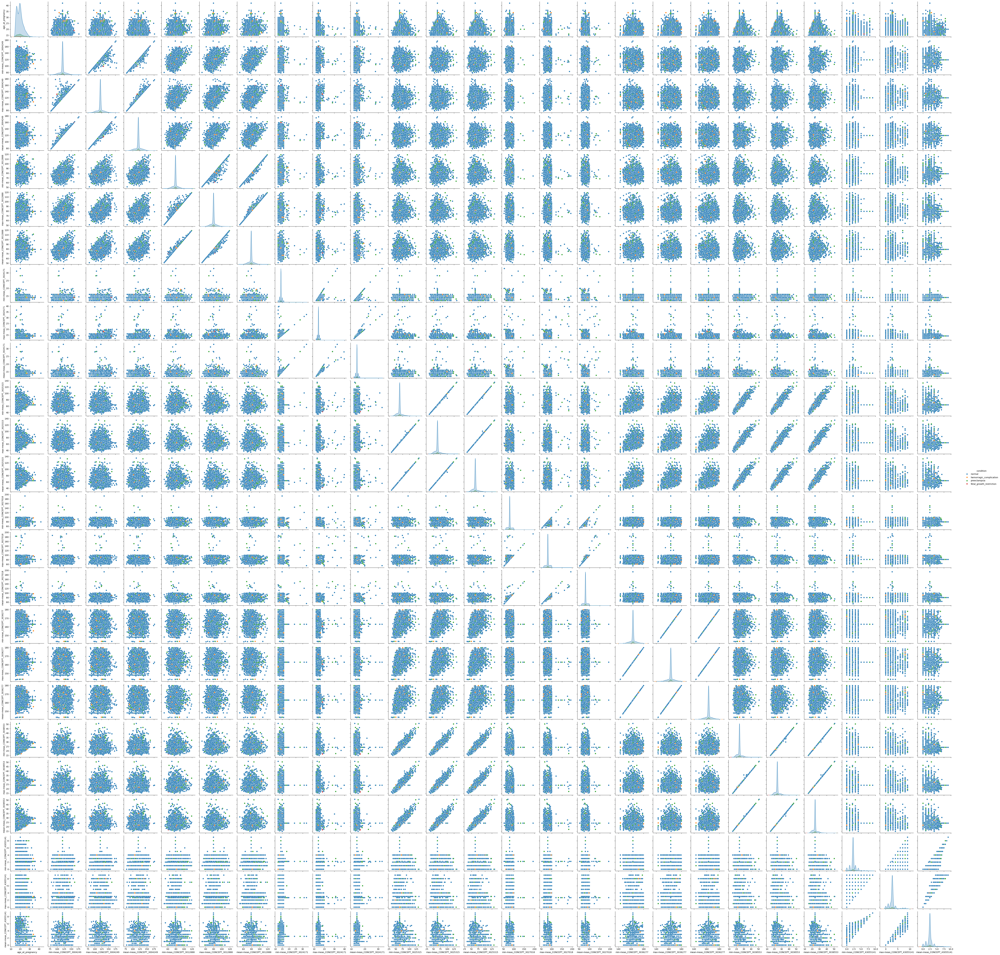

In [186]:
# Mapa de Correlación Variables continuas
x_cont = pd.concat([features_cont_cleaned_imputed, pd.DataFrame(target)], axis=1)
sns.pairplot(x_cont, hue = 'condition')

De la misma manera el hallazmos mas importante encontrado en este apartado es el solapamiento de las distribuciones, esto nos indica que el modelo de datos sintéticos no discrimina las variables y que los fenotipos sólo están basados en el porcentaje asignado.

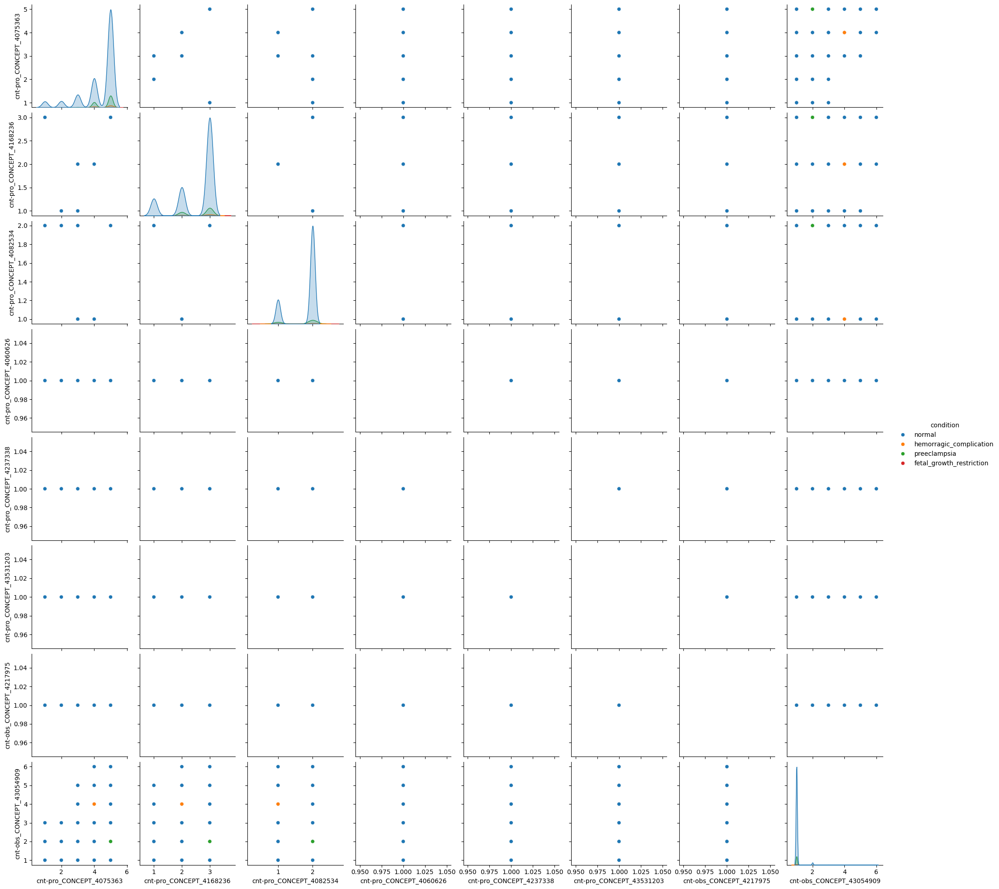

In [187]:
# Mapa de Correlación Variables Discretas
x_disc = pd.concat([features_disc_cleaned_imputed, pd.DataFrame(target)], axis=1)
sns.pairplot(x_disc, hue = 'condition')

In [188]:
#Separación de los conjuntos de Train y Test
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)
clases = np.unique(y)

In [189]:
# Preprocesador: escalar solo las variables continuas
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler

columnas_continuas = features_cont_cleaned_imputed.columns.tolist()

preprocessor = ColumnTransformer(
    transformers=[
        ('scaler', StandardScaler(), columnas_continuas)
    ],
    remainder='passthrough'  # Las discretas quedan igual
)

In [190]:
# Definimos los modelos que vamos a utilizar y los hiperparámetros a optimizar:

modelos = {
    'LogisticRegression': {
        'model': LogisticRegression(max_iter=10000, random_state=42),
        'params': {
            'clf__C': uniform(0.1, 5),
            'clf__penalty': ['l1', 'l2'],
            'clf__solver': ['saga'],
        }
    },
    'RandomForest': {
        'model': RandomForestClassifier(random_state=42),
        'params': {
            'clf__n_estimators': randint(100, 300),
            'clf__max_depth': [None, 10, 20, 30]
        }
    },
    'XGBoost': {
        'model': XGBClassifier(eval_metric='mlogloss', random_state=42),
        'params': {
            'clf__n_estimators': randint(100, 300),
            'clf__max_depth': randint(3, 10),
            'clf__learning_rate': uniform(0.01, 0.2)
        }
    },
    'KNN': {
        'model': KNeighborsClassifier(),
        'params': {
            'clf__n_neighbors': [3, 5, 7, 9],
            'clf__weights': ['uniform', 'distance'],
            'clf__p': [1, 2],
            'clf__leaf_size': [20, 30] 
        }
}
    # Si queremos SVM
    # 'SVM': {
    #     'model': SVC(probability=True, random_state=42),
    #     'params': {
    #         'clf__C': uniform(0.1, 5),
    #         'clf__kernel': ['linear'],
    #         'clf__gamma': ['scale']
    #     }
    # }
}

In [191]:
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from collections import defaultdict
from sklearn.pipeline import Pipeline

resultados_modelos = defaultdict(dict)

for nombre, dic in modelos.items():
    print(f"\n🔍 Random Search para {nombre}")
    pipe = Pipeline([
        ('preprocessing', preprocessor),
        ('clf', dic['model'])
    ])
    
    random_search = RandomizedSearchCV(
        pipe, dic['params'],
        n_iter=15,
        cv=StratifiedKFold(10, shuffle=True, random_state=42),
        scoring='f1_macro',
        n_jobs=-1,
        random_state=42,
        verbose=1
    )
    
    random_search.fit(X_train, y_train)
    
    print(f"✅ Mejor F1 (CV): {random_search.best_score_:.4f}")
    print(f"⚙️ Mejores parámetros: {random_search.best_params_}")
    
    # Guardamos resultados
    resultados_modelos[nombre]['modelo'] = random_search.best_estimator_
    resultados_modelos[nombre]['score_cv'] = random_search.best_score_


🔍 Random Search para LogisticRegression
Fitting 10 folds for each of 15 candidates, totalling 150 fits
✅ Mejor F1 (CV): 0.2374
⚙️ Mejores parámetros: {'clf__C': np.float64(1.9727005942368125), 'clf__penalty': 'l1', 'clf__solver': 'saga'}

🔍 Random Search para RandomForest
Fitting 10 folds for each of 15 candidates, totalling 150 fits
✅ Mejor F1 (CV): 0.2437
⚙️ Mejores parámetros: {'clf__max_depth': None, 'clf__n_estimators': 101}

🔍 Random Search para XGBoost
Fitting 10 folds for each of 15 candidates, totalling 150 fits
✅ Mejor F1 (CV): 0.2455
⚙️ Mejores parámetros: {'clf__learning_rate': np.float64(0.10121399684340719), 'clf__max_depth': 9, 'clf__n_estimators': 289}

🔍 Random Search para KNN
Fitting 10 folds for each of 15 candidates, totalling 150 fits
✅ Mejor F1 (CV): 0.2529
⚙️ Mejores parámetros: {'clf__weights': 'distance', 'clf__p': 1, 'clf__n_neighbors': 3, 'clf__leaf_size': 30}



📌 Evaluando modelo: LogisticRegression
                          precision    recall  f1-score   support

fetal_growth_restriction       0.00      0.00      0.00         4
 hemorragic_complication       0.00      0.00      0.00        27
                  normal       0.90      1.00      0.95      1459
            preeclampsia       0.00      0.00      0.00       124

                accuracy                           0.90      1614
               macro avg       0.23      0.25      0.24      1614
            weighted avg       0.82      0.90      0.86      1614


📌 Evaluando modelo: RandomForest
                          precision    recall  f1-score   support

fetal_growth_restriction       0.00      0.00      0.00         4
 hemorragic_complication       0.00      0.00      0.00        27
                  normal       0.90      1.00      0.95      1459
            preeclampsia       0.17      0.01      0.02       124

                accuracy                           0.90      16

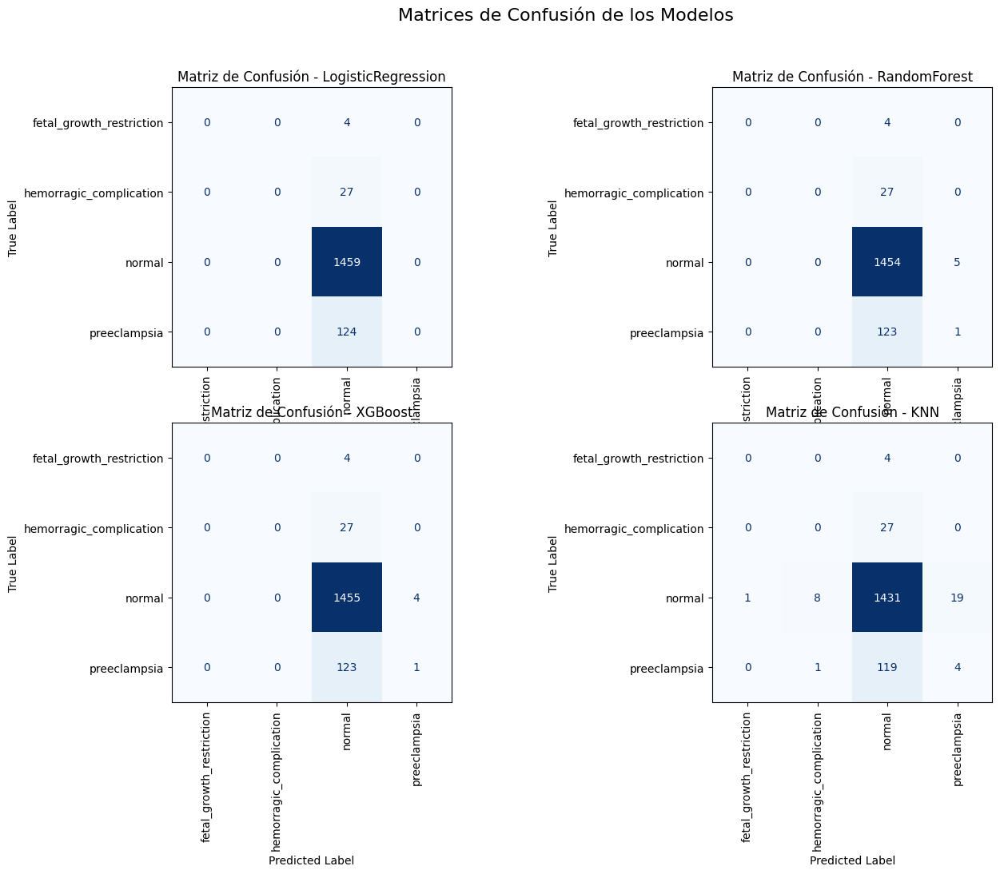

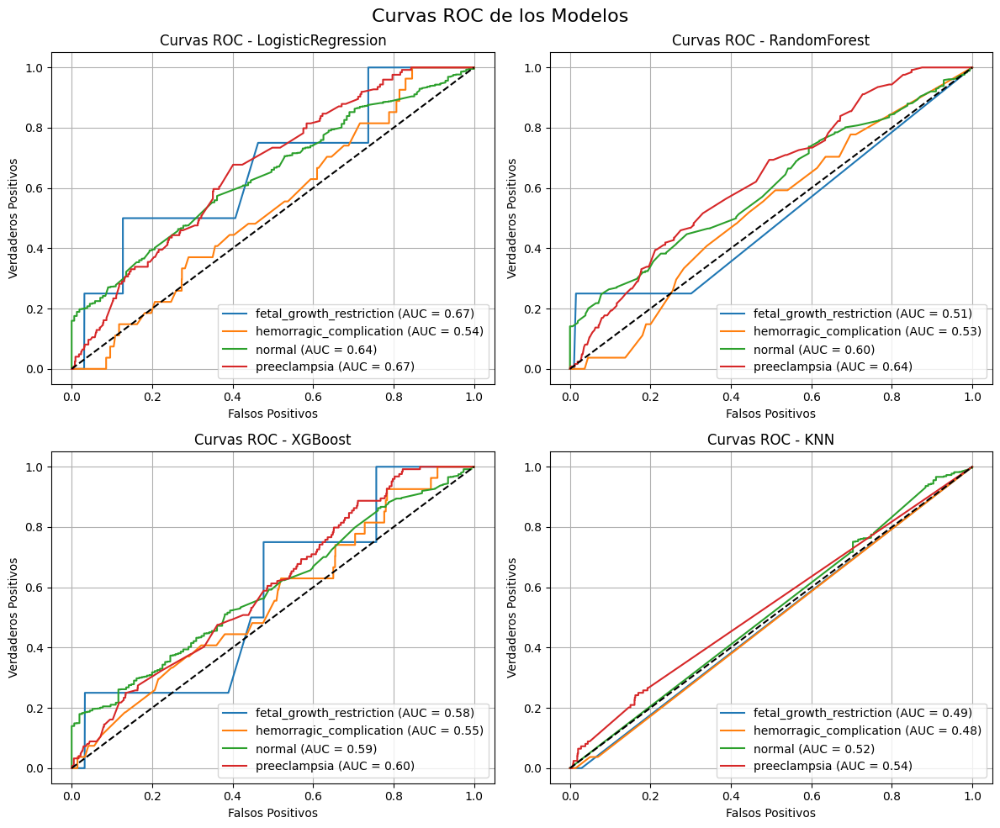

In [192]:
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
from sklearn.preprocessing import label_binarize

# Configuración general
n_modelos = len(resultados_modelos)
fig_cm, axs_cm = plt.subplots(2, 2, figsize=(16, 10))  # 4 subplots para matrices de confusión
fig_roc, axs_roc = plt.subplots(2, 2, figsize=(12, 10))  # 4 subplots para curvas ROC

for idx, (nombre, info) in enumerate(resultados_modelos.items()):
    print(f"\n📌 Evaluando modelo: {nombre}")
    
    modelo = info['modelo']
    y_pred = modelo.predict(X_test)
    
    # Reporte de clasificación
    print(classification_report(
        y_test, y_pred, 
        target_names=le.inverse_transform(clases).astype(str), 
        zero_division=0
    ))
    
    # ---------------- Matriz de Confusión ----------------
    cm = confusion_matrix(y_test, y_pred)
    row, col = divmod(idx, 2)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=le.inverse_transform(clases))
    disp.plot(ax=axs_cm[row][col], cmap='Blues', values_format='d', colorbar=False)
    axs_cm[row][col].set_title(f'Matriz de Confusión - {nombre}')
    axs_cm[row][col].set_xlabel('Predicted Label')
    axs_cm[row][col].set_ylabel('True Label')
    axs_cm[row][col].tick_params(axis='x', rotation=90)

    # ---------------- Curvas ROC ----------------
    if hasattr(modelo.named_steps['clf'], "predict_proba"):
        y_score = modelo.predict_proba(X_test)
        y_test_bin = label_binarize(y_test, classes=clases)
        
        fpr, tpr, roc_auc = {}, {}, {}
        for i in range(len(clases)):
            fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        row, col = divmod(idx, 2)
        ax = axs_roc[row][col]
        for i in range(len(clases)):
            label_name = le.inverse_transform(clases)[i]
            ax.plot(fpr[i], tpr[i], label=f'{label_name} (AUC = {roc_auc[i]:.2f})')
        
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_title(f'Curvas ROC - {nombre}')
        ax.set_xlabel('Falsos Positivos')
        ax.set_ylabel('Verdaderos Positivos')
        ax.legend(loc='lower right')
        ax.grid()
    else:
        print(f"⚠️ El modelo {nombre} no tiene predict_proba, no se genera curva ROC.")

# Ajuste final
fig_cm.suptitle('Matrices de Confusión de los Modelos', fontsize=16)
fig_roc.suptitle('Curvas ROC de los Modelos', fontsize=16)
plt.tight_layout()
plt.show()


In [193]:
# Extraemos solo los modelos
modelos_guardar = {nombre: info['modelo'] for nombre, info in resultados_modelos.items()}

# Guardamos todos en un archivo
joblib.dump(modelos_guardar, 'modelos_entrenados.pkl')

['modelos_entrenados.pkl']